# <font color=green>deepBreaks Applications</font>
## Modeling spectral tuning sites of opsin proteins based on amino-acid sequence...  

# <font color=red>Step 0: mySQL DB Setup -</font> Script 0
## *The following text is a script written in mySQL format. You can copy and paste this directly into a mySQL text file or query window within mySQL workbench.*
```
DROP DATABASE vizphiz;
CREATE DATABASE vizphiz;
USE vizphiz;

CREATE TABLE lamdamax
(
id int unsigned not null primary key,
genus varchar(50),
species varchar(50),
celltype varchar(50),
cellsubtype varchar(50),
lamdamax decimal(9,5),
error decimal(9,5),
chromophore varchar(50),
method varchar(50),
stage varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE heterologous
(
hetid int unsigned not null primary key,
genus  varchar(50),
species varchar(50),
accession varchar(500),
mutations varchar(500),
lamdamax decimal(9,5),
error decimal(9,5),
cellculture varchar(50),
purification varchar(50),
spectrum varchar(50),
sourcetype varchar(50),
refid int,
notes varchar(1000)
);

CREATE TABLE links
(
linkid int unsigned not null primary key,
accession varchar(500),
maxid int,
refid int,
evidence varchar(1000)
);

CREATE TABLE search
(
searchid int unsigned not null primary key,
researcher varchar(50),
month int,
year int,
engine varchar(500),
keywords varchar(500)
);

CREATE TABLE opsins
(
opsinid int unsigned not null primary key,
genefamily varchar(50),
genenames varchar(50),
genus varchar(50),
phylum varchar(25,)
species varchar(50),
db varchar(50),
accession varchar(500),
dna varchar(10000),
aa varchar(3333),
refid int
);

CREATE TABLE refs
(
refid int,
doilink varchar(100),
searchid int
);
``` 

In [1]:
#All neccessary packages to import for data process steps.
import mysql
import mysql.connector
#install mysql-connector-python // NOT mysql-connector
import re
import subprocess

# <font color=red>STEP 0: Data Base Setup -</font> Script 1 - Import heterologous.tsv into mySQL


In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('heterologous.tsv', 'r', encoding="utf8")
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")
    print(columns)
    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.heterologous (hetid, genus, species, accession, mutations, lamdamax, error, cellculture, purification, spectrum, sourcetype, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10], columns[11])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")

# <font color=red>STEP 0: Data Base Setup -</font> Script 2 - Import opsindb.tsv into mySQL

In [ ]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database= "vizphiz",
  password= "Geass5566!!"
)

#read file for data
file1 = open('opsindb.tsv', 'r')
Lines = file1.readlines()

count=0
for line in Lines:
    columns = line.split("\t")

    mycursor = mydb.cursor()

    sql = "INSERT INTO opsins.opsins (opsinid, genefamily, genenames, genus, species, phylum, db, accession, dna, aa, refid) VALUES (%s, %s, %s, %s, %s, %s, %s, %s, %s, %s)"
    val = (columns[0], columns[1], columns[2], columns[3], columns[4], columns[5], columns[6], columns[7], columns[8], columns[9], columns[10])
    print(sql)
    print(val)

    mycursor.execute(sql, val)

    mydb.commit()

    print(mycursor.rowcount, "record inserted.")


# <font color=red>STEP 1: Extract Data From Vizphiz</font>
### Output = 5 different 'versions' // 'splits' of the data. 
### !Take outputs and run through MAFFT before moving on to STEP2!
### Suggested parameters for 'mafft' alignment are...
1. Fasta Format (Sorted)

2. Strategy = FFT-NS-2 // G-INS-1

In [ ]:
wd_output = 'wds.txt'
sws_output = 'swd.txt'
mws_output = 'mwd.txt'
rod_output = 'rod.txt'
wd_ni_output = 'wds_ni.txt'
nmoc_output = 'nmoc.txt'
wh_metadata = 'wds_meta.tsv'
sw_metadata = 'sws_meta.tsv'
mw_metadata = 'mws_meta.tsv'
rh_metadata = 'rod_meta.tsv'
wd_ni_metadata = 'wds_ni_meta.tsv'
nmoc_metadata = "nmoc_meta.tsv"
m = 0
s = 0
l = 0
r = 0
c = 0
z = 0

mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  database="vizphiz",
  password="Geass5566!!"
) 
mycursor = mydb.cursor()

sql = "select DISTINCT o.genus,o.species,o.genefamily,o.accession,h.lamdamax,o.aa,o.phylum from opsins.opsins o, opsins.heterologous h WHERE (o.accession = h.accession AND o.refid = h.refid); "
mycursor.execute(sql)
myresult = mycursor.fetchall()


for x in myresult:       
#REG-DATA SECTION    
  with open(wd_output, 'a') as f:
    if m == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if(x[3]) == "NM_001014890.2":
      pass
    else:
      m += 1 
      #This makes the fasta format file
      seq = ">S" + str(m)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(wd_ni_output, 'a') as f:
  p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
  if (p.match(x[2])):
    pass
  else:
    if c == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if(x[3]) == "NM_001014890.2" or (x[0] == "Limenitis " or "Papilio "):
      pass
    else:
      c += 1 
      #This makes the fasta format file
      seq = ">S" + str(c)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(nmoc_output, 'a') as f:
  p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
  if (p.search(x[3]) or "-" in x[3]):
    pass
  else:
    if z == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if(x[3]) == "NM_001014890.2":
      pass
    else:
      z += 1 
      #This makes the fasta format file
      seq = ">S" + str(z)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

  with open(sws_output, 'a') as f:
  p = re.compile('^SWS|^UVS')
  if p.match(x[2]):
    s+=1
    if s == 1:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")  
  #This makes the fasta format file
    seq = ">S" + str(s)
    f.write(seq)
    seq2 = str('\n' + x[5] + '\n')
    f.write(seq2)

  with open(mws_output, 'a') as f:
  p = re.compile('^MWS|^LWS')
  if p.match(x[2]):
    l+=1
    if l == 1:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    #This makes the fasta format file
    seq = ">S" + str(l)
    f.write(seq)
    seq2 = str('\n' + x[5] + '\n')
    f.write(seq2)

  with open(rod_output, 'a') as f:
  p = re.compile('Rh[0-2]|exoRh')
  if p.match(x[2]):
    if r == 0:
      f.write(">Bovine\nMNGTEGPNFYVPFSNKTGVVRSPFEAPQYYLAEPWQFSMLAAYMFLLIMLGFPINFLTLYVTVQHKKLRTPLNYILLNLAVADLFMVFGGFTTTLYTSLHGYFVFGPTGCNLEGFFATLGGEIALWSLVVLAIERYVVVCKPMSNFRFGENHAIMGVAFTWVMALACAAPPLVGWSRYIPEGMQCSCGIDYYTPHEETNNESFVIYMFVVHFIIPLIVIFFCYGQLVFTVKEAAAQQQESATTQKAEKEVTRMVIIMVIAFLICWLPYAGVAFYIFTHQGSDFGPIFMTIPAFFAKTSAVYNPVIYIMMNKQFRNCMVTTLCCGKNPLGDDEASTTVSKTETSQVAPA\n")
    if(x[3]) == "NM_001014890.2" or (x[0] == "Limenitis " or "Papilio "):
      pass
    else:
      r+=1
      #This makes the fasta format file
      seq = ">S" + str(r)
      f.write(seq)
      seq2 = str('\n' + x[5] + '\n')
      f.write(seq2)

#METADATA SECTION
  with open(wh_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
  if m == 1:
    g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
    g.write("Bovine\t500.000\tBos_taurus\tRh1\tNM_001014890\n")
  if(x[3]) == "NM_001014890.2":
    pass
  else:        
    md =  str("S" + str(m) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
    g.write(md)

  with open(wd_ni_metadata, 'a') as g:
  p = re.compile('^Rtc|^BRh[0-3]|Pr[A-Z]|Rh1,Rh3|^IV|^inv')
  if p.match(x[2]):
    pass
  #This makes the metadata formatted for a linear regression model.
  else:
    if c == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
      g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
    if(x[3]) == "NM_001014890.2" or (x[0] == "Limenitis " or "Papilio "):
      pass
    else:  
      md =  str("S" + str(c) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(sw_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
  p = re.compile('^SWS|^UVS')
  if p.match(x[2]):
    if s == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
      g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
    md =  str("S" + str(s) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
    g.write(md)

  with open(mw_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
  p = re.compile('^MWS|^LWS')
  if p.match(x[2]):
    if l == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
      g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")  
    md =  str("S" + str(l) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
    g.write(md)

  with open(rh_metadata, 'a') as g:
  #This makes the metadata formatted for a linear regression model.
  p = re.compile('Rh[0-3]|exoRh')
  if p.match(x[2]):
    if r == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")
      g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
    if(x[3]) == "NM_001014890.2" or (x[0] == "Limenitis " or "Papilio "):
      pass
    else:  
      md =  str("S" + str(r) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

  with open(nmoc_metadata, 'a') as g:
  p = re.compile('[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T][0-9]+[G,A,L,M,F,W,K,Q,E,S,P,V,I,C,Y,H,R,N,D,T]')
  if (p.search(x[3]) or "-" in x[3]):
    pass
  else:
    if z == 1:
      g.write("\tLambda_Max\tSpecies\tOpsin_Family\tAccession\n")  
      g.write("Bovine\t500.0000\tBos_taurus\tRh1\tNM_001014890\n")
    if(x[3]) == "NM_001014890.2" or (x[4] == 0):
      pass
    else:        
      md =  str("S" + str(z) + "\t" + str(x[4]).strip()) + "\t" + str(x[0]).strip().replace(' ','') + "_" + str(x[1]).strip().replace(' ','') + "\t" + str(x[2]).strip() + "\t" + x[3].strip() + "\n"
      g.write(md)

# <font color=red>STEP 2: Format Alignments for 'deepBreaks'</font>
## REMINDER - Take outputs from STEP 1 and run through MAFFT before moving on to STEP2


In [327]:
#enter list of aligned text files here.
inputs = ['extra_dataset\wds3_aligned.txt']
# inputs = ['wds_aligned.txt','wds_ni_aligned.txt','rod_aligned.txt','nmoc_aligned.txt']
##enter list of names for desired formatted fasta files here.
output = ['wds3_fmt.fasta']
# output = ['wds_fmt.fasta','wds_ni_fmt.fasta','rod_fmt.fasta','nmoc_fmt.fasta']
i=0
k = 0
for files in inputs:
    lines = open(inputs[i]).readlines()
    file = open(output[i], 'a+')
    #line_count = len(lines)
    #tab_entry = ""
    #call = input("How Many Lines Per Alignment?: ")
    #count = int(call)
    #loop = range(int(count))
    m=0
    for line in lines:
        snip = str(lines[k])
        if '>' in snip:
            if m == 0:
                m+=1
            else:
                file.write("\n")
            file.write(snip)
        else:
            entry = ""
            entry = str(snip.replace("\n",""))
            file.write(entry)
        k+=1
    k = 0
    i+=1
    file.close()

# <font color=red>STEP 3: deepBreaks</font>
## THIS IS A LONG SECTION! 
### STEP 4 doesn't start until Cell 34

In [1]:
# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os

In [2]:
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')

In [3]:
# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'v4_result_files/t1_opsin_test/wds2_fmt.fasta' 

# path to metadata
metaDataFileName = 'v4_result_files/t1_opsin_test/wds_t1_and_t2_opsin_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 


In [4]:
# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

direcory preparation


In [5]:
%%time
print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)
tr.shape


reading meta-data
reading fasta file
CPU times: total: 672 ms
Wall time: 677 ms


(1766, 381)

In [6]:
#start here with removing the bottom ~25 sequences 
msp = tr.iloc[1731:].copy()
msp.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p372,p373,p374,p375,p376,p377,p378,p379,p380,p381
Neogonodactylus_oerstedii|334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Neogonodactylus_oerstedii|383,NaN,NaN,NaN,D,NaN,W,E,N,V,G,...,NaN,NaN,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bombus_impatiens|539,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,D,NaN,N,E,K,S,N,A,NaN,NaN
Bombus_impatiens|424,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,T,E,K,I,K,S,D,D
Bombus_impatiens|347,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,P,A,A,S,S,NaN,NaN,NaN


In [7]:

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

(1730, 382)

In [8]:
tr.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p373,p374,p375,p376,p377,p378,p379,p380,p381,Lambda_Max
AR1,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN,558.0
AR1D108N,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN,564.0
AR1E216Q,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN,557.0
AR2,I,A,L,Q,A,NaN,NaN,NaN,NaN,NaN,...,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN,548.0
AR2D107N,I,A,L,Q,A,NaN,NaN,NaN,NaN,NaN,...,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN,549.0


In [9]:
import numpy as np
import csv
import pandas as pd

In [10]:
sample_n = 100
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1


In [11]:
unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)


In [12]:
base_test = meta_data.loc[drop_indices].copy()
base_test.head()

,Lambda_Max,Species,Opsin_Family,Accession
Column1,,,,
S673,363.0,swsanc3_sp.,UVS,"swsanc3_A111S,L112I,E113D,L116V,S118T"
S542,487.0,Bos_taurus,Rh1,NM_001014890.2_G90S
S473,517.0,Oryzias_luzonensis,Rh2,LC260049
PoXeR,564.0,PoXeR,T1,Null
PoXeR,575.0,PoXeR,T1,Null


In [13]:
y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)

Shape of data is:  (1629, 381)


In [14]:
bovine = tr.loc['Bovine'].copy()

print(bovine)

bovine.to_csv(path_or_buf= f'{report_dir}/bovine.csv',index = True,mode="w")

p1        M
p2        G
p3        T
p4        E
p5      NaN
       ... 
p377      Q
p378      V
p379      A
p380      P
p381      A
Name: Bovine, Length: 381, dtype: object


In [15]:
unseen.head()

,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p372,p373,p374,p375,p376,p377,p378,p379,p380,p381
S673,M,NaN,E,E,NaN,NaN,E,D,F,Y,...,S,V,S,S,S,Q,V,S,P,S
S542,M,G,T,E,NaN,G,P,N,F,Y,...,NaN,NaN,NaN,T,S,Q,V,A,P,A
S473,P,G,T,E,NaN,G,Q,N,F,Y,...,T,A,A,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PoXeR,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PoXeR,M,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Attention**: metadata and sequences data should have the names as their row names and for each sequence their must be a value in the meta data file.

In [16]:
print('metadata looks like this:')
meta_data.head()

metadata looks like this:


,Lambda_Max,Species,Opsin_Family,Accession
Column1,,,,
Bovine,500.0,Bos_tarus.0000,Rh1,NM_001014890
S1,502.0,Neoniphon_sammara,Rh1,U57536.1
S2,502.0,Neoniphon_argenteus,Rh1,U57540.1
S3,481.0,Neoniphon_aurolineatus,Rh1,U57541.1
S4,494.0,Sargocentron_punctatissimum,Rh1,U57543.1


In [17]:
print('sequence data looks like this:')
tr.head()

sequence data looks like this:


,p1,p2,p3,p4,p5,p6,p7,p8,p9,p10,...,p372,p373,p374,p375,p376,p377,p378,p379,p380,p381
AR1,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,S,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN
AR1D108N,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,S,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN
AR1E216Q,I,A,L,T,A,NaN,NaN,NaN,NaN,NaN,...,S,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN
AR2D107N,I,A,L,Q,A,NaN,NaN,NaN,NaN,NaN,...,S,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN
AR2E215Q,I,A,L,Q,A,NaN,NaN,NaN,NaN,NaN,...,S,NaN,A,A,D,NaN,NaN,NaN,NaN,NaN


### Preprocessing
In this step, we do all these steps:
1. dropping columns with a number of missing values above a certain threshold  
2. dropping zero entropy columns  
3. imputing missing values with the mode of that column  
4. replacing cases with a frequency below a threshold (default 1.5%) with the mode of that column
5. dropping zero entropy columns
6. use statistical tests (each position against the phenotype) and drop columns with p-values below a threshold (default 0.25)
7. one-hot encode the remaining columns
8. calculate the pair-wise distance matrix for all of the columns
9. use the distance matrix for DBSCAN and cluster the correlated positions together
10. keep only one column (closes to center of each cluster) for each group and drop the rest from the training data set

In [18]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=False)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=False))
    ])

In [19]:
%%time
report, top = model_compare_cv(X=tr, y=y, preprocess_pipe=prep_pipeline,
                               models_dict=get_models(ana_type=ana_type),
                               scoring=get_scores(ana_type=ana_type),
                               report_dir=report_dir,
                               cv=12, ana_type=ana_type, cache_dir=report_dir)

Fitting rf...


Fitting Adaboost...
Fitting et...
Fitting gbc...
Fitting dt...
Fitting lr...
Fitting Lasso...
Fitting LassoLars...
Fitting BayesianRidge...
Fitting HubR...
Fitting lgbm...
Fitting xgb...
CPU times: total: 14 s
Wall time: 4min 42s


MAE = Mean Absolute Error

MSE = Mean Squared Error

RMSE = Rooted Mean Square Error

MAPE = Mean Absolute % Error - the average magnitude of error produced by a model, or how far off predictions are on average. A MAPE value of 20% means that the average absolute percentage difference between the predictions and the actuals is 20%

In [20]:
report

,R2,MAE,MSE,RMSE,MAPE
BayesianRidge,9.338424e-01,9.656286e+00,2.345855e+02,1.500937e+01,1.970731e-02
lgbm,9.285925e-01,8.919197e+00,2.518595e+02,1.538444e+01,1.813731e-02
xgb,9.215936e-01,8.919706e+00,2.774328e+02,1.628787e+01,1.806591e-02
gbc,9.210580e-01,1.054231e+01,2.800816e+02,1.629136e+01,2.150593e-02
rf,9.179851e-01,9.100305e+00,2.897919e+02,1.656049e+01,1.841140e-02
et,8.957487e-01,9.997704e+00,3.687158e+02,1.880865e+01,2.020975e-02
dt,8.898149e-01,1.027892e+01,3.895317e+02,1.936488e+01,2.084172e-02
HubR,8.879884e-01,1.168845e+01,3.954010e+02,1.965553e+01,2.368274e-02
Lasso,8.652410e-01,1.624794e+01,4.780142e+02,2.180764e+01,3.348503e-02
LassoLars,8.652368e-01,1.624813e+01,4.780277e+02,2.180787e+01,3.348536e-02


In [21]:
train_hold = tr

In [22]:
prep_pipeline = make_pipeline(
    steps=[
        ('mc', MisCare(missing_threshold=0.05)),
        ('cc', ConstantCare()),
        ('ur', URareCare(threshold=0.025)),
        ('cc2', ConstantCare()),
        ('one_hot', CustomOneHotEncoder()),
        ('feature_selection', FeatureSelection(model_type=ana_type, alpha=0.10, keep=True)),
        ('collinear_care', CollinearCare(dist_method='correlation', threshold=0.05, keep=True))
    ])

In [23]:
modified_top = []
for model in top:
    modified_top.append(make_pipeline(steps=[('prep', prep_pipeline), model.steps[-1]]))

In [24]:
modified_top[0]

Pipeline(steps=[('prep',
                 Pipeline(steps=[('mc', MisCare(missing_threshold=0.05)),
                                 ('cc', ConstantCare()),
                                 ('ur', URareCare(threshold=0.025)),
                                 ('cc2', ConstantCare()),
                                 ('one_hot', CustomOneHotEncoder()),
                                 ('feature_selection',
                                  FeatureSelection(alpha=0.1, keep=True,
                                                   model_type='reg')),
                                 ('collinear_care',
                                  CollinearCare(dist_method='correlation',
                                                keep=True, threshold=0.05))])),
                ('BayesianRidge', BayesianRidge())])

In [25]:
%%time
top = finalize_top(X=tr, y=y, top_models=modified_top, grid_param=get_params(),report_dir=report_dir, cv=10)


Tuning BayesianRidge...


Tuning lgbm...
Tuning xgb...
CPU times: total: 46.2 s
Wall time: 14.4 s


In [26]:
%%time
sr = summarize_results(top_models=top, report_dir=report_dir)

CPU times: total: 4.62 s
Wall time: 3.41 s


In [27]:
sr.head()

,feature,p_value,score,BayesianRidge,lgbm,xgb,mean
0,p1_L,7.053989e-46,215.326156,0.062176,0.216216,0.000027,0.092806
1,p1_M,1.120393e-45,214.283448,0.002302,0.067568,0.000010,0.023293
2,p1_NQFIPGAVKTH,2.364700e-06,22.433405,0.046214,0.013514,0.000011,0.019913
3,p2_G,3.192428e-01,0.992654,0.000000,0.000000,0.000000,0.000000
4,p2_GAP,2.757127e-105,551.659062,0.031432,0.013514,0.000061,0.015002


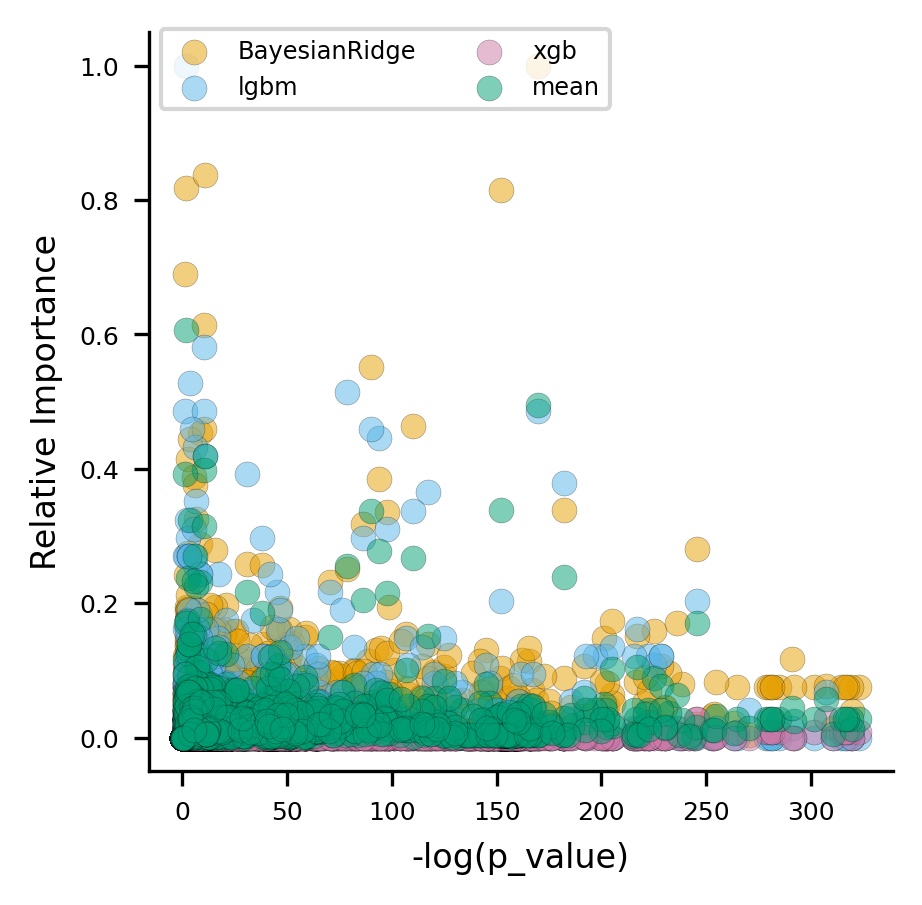

In [28]:
scatter_plot = plot_scatter(summary_result=sr, report_dir=report_dir)

In [29]:
%%time
mean_imp = mean_importance(top, report_dir=report_dir)

CPU times: total: 219 ms
Wall time: 222 ms


mean Done


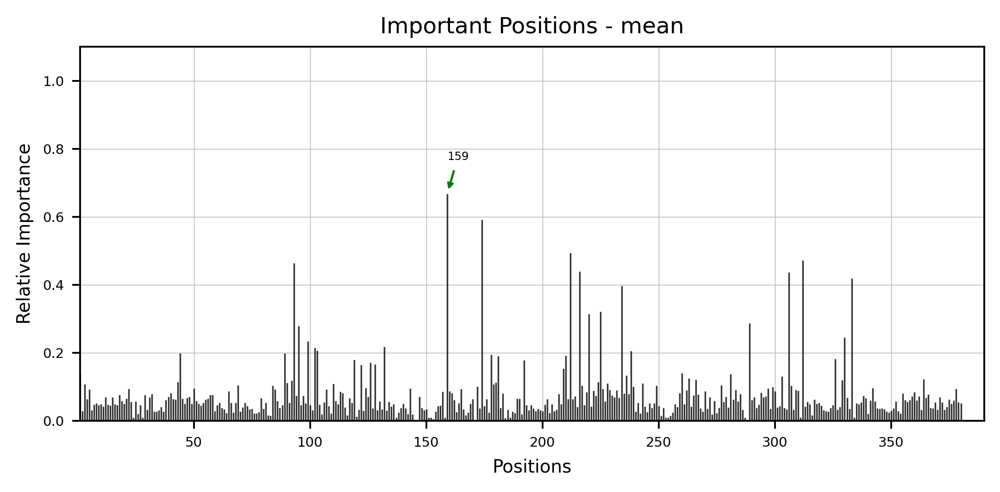

In [30]:
dp_plot(importance=mean_imp,imp_col='mean', model_name='mean', report_dir=report_dir)

In [31]:
tr = prep_pipeline[:4].fit_transform(tr)

BayesianRidge Done
BayesianRidge  Done
lgbm Done
lgbm  Done
xgb Done
xgb  Done


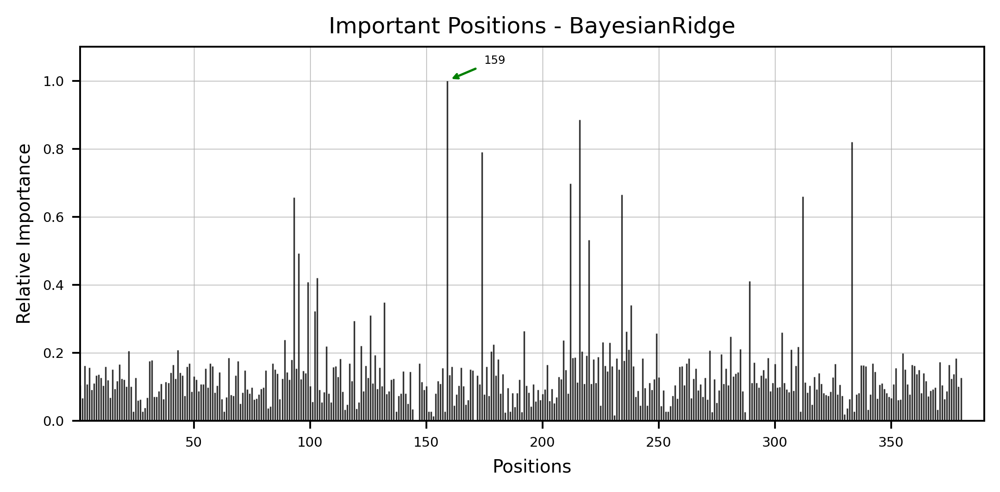

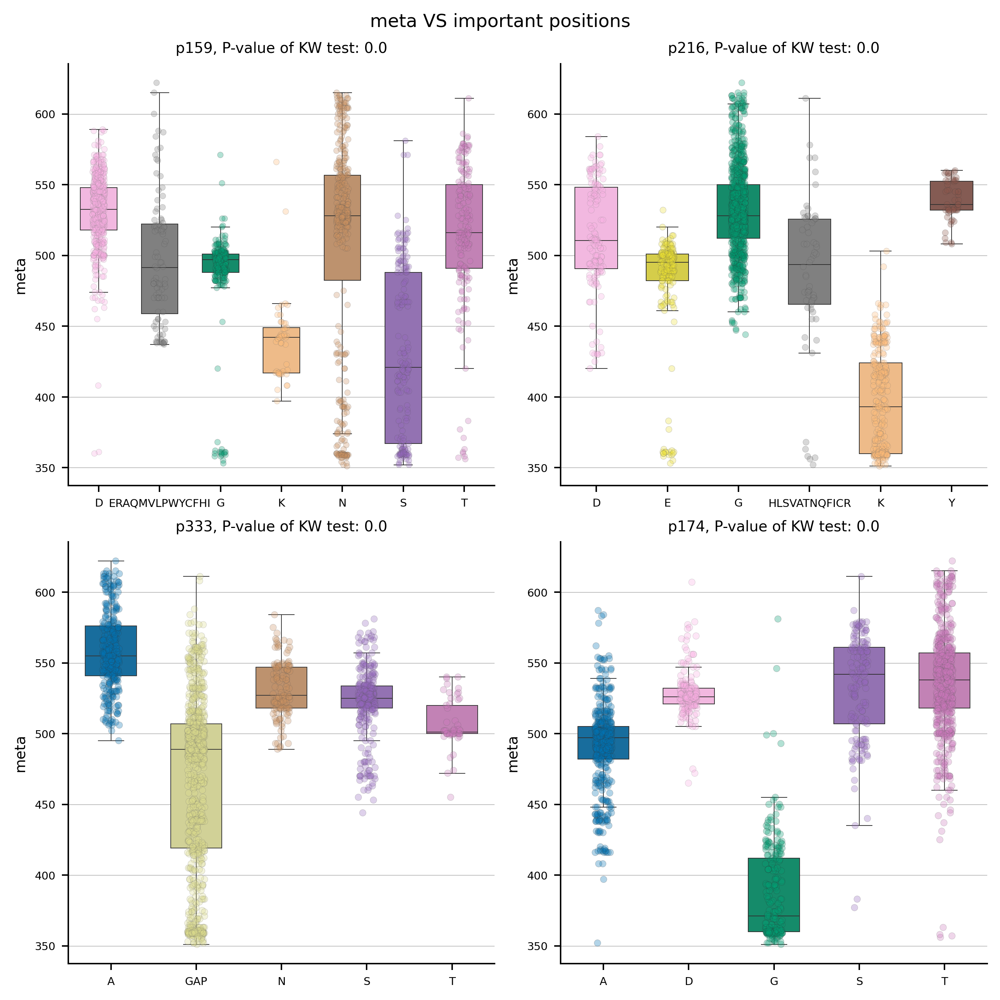

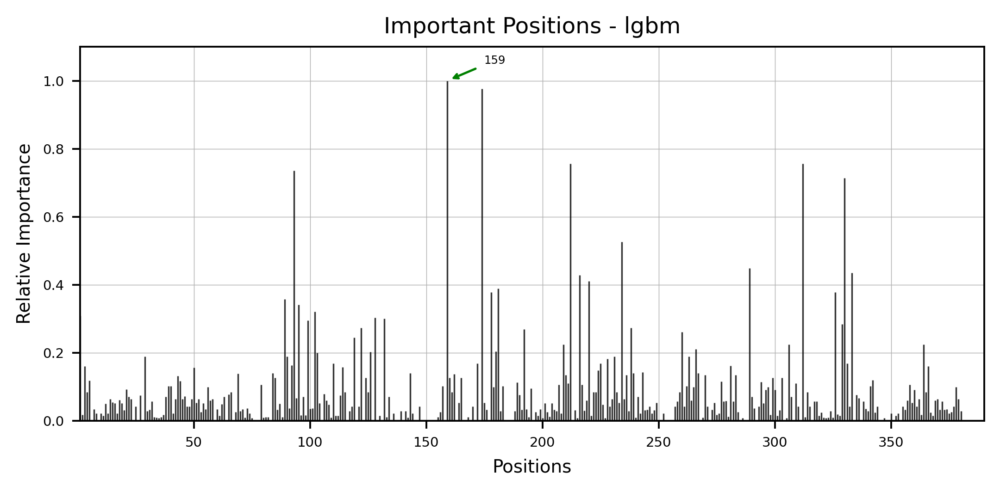

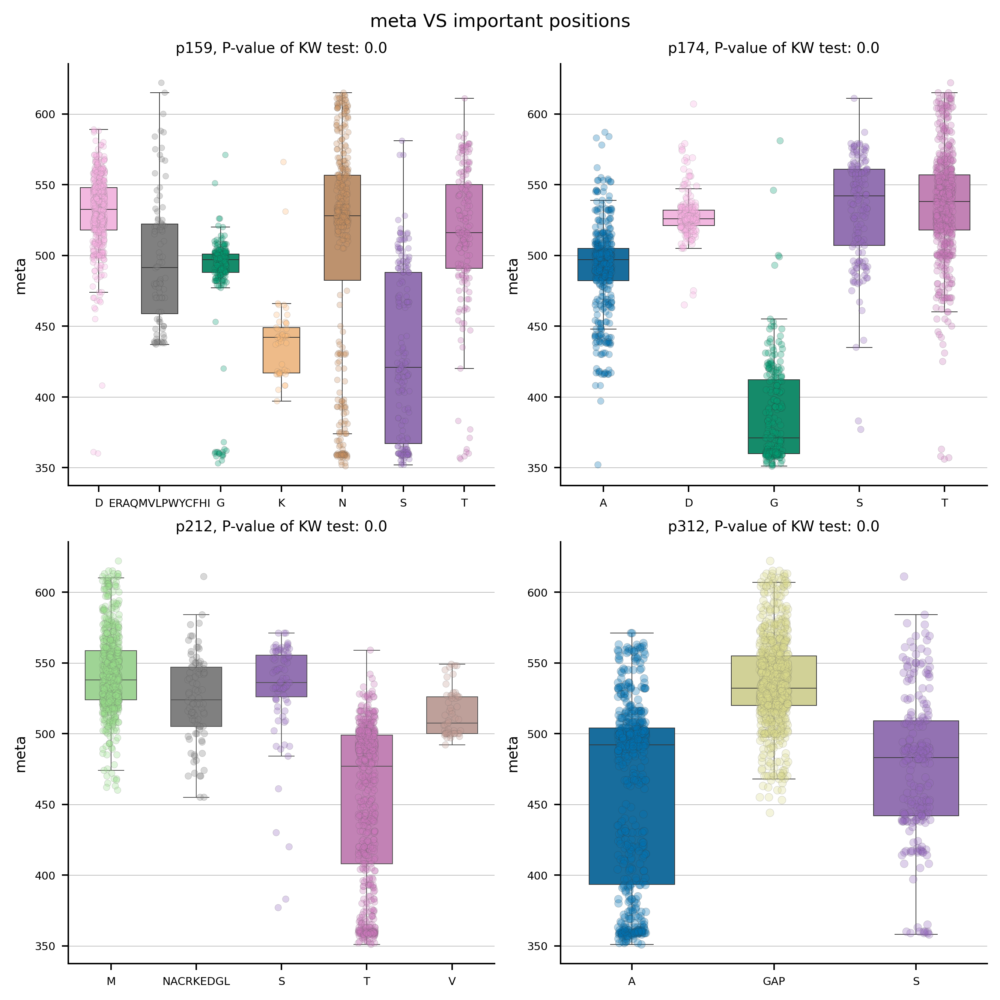

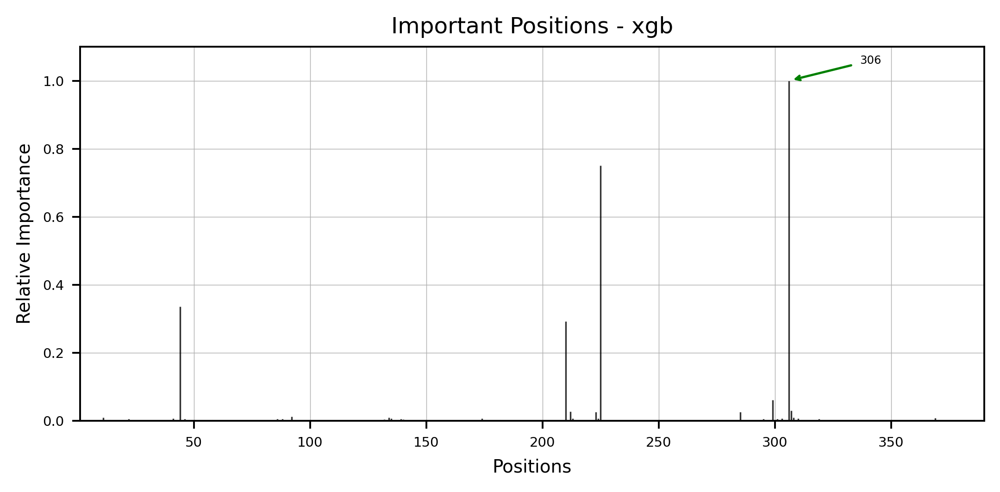

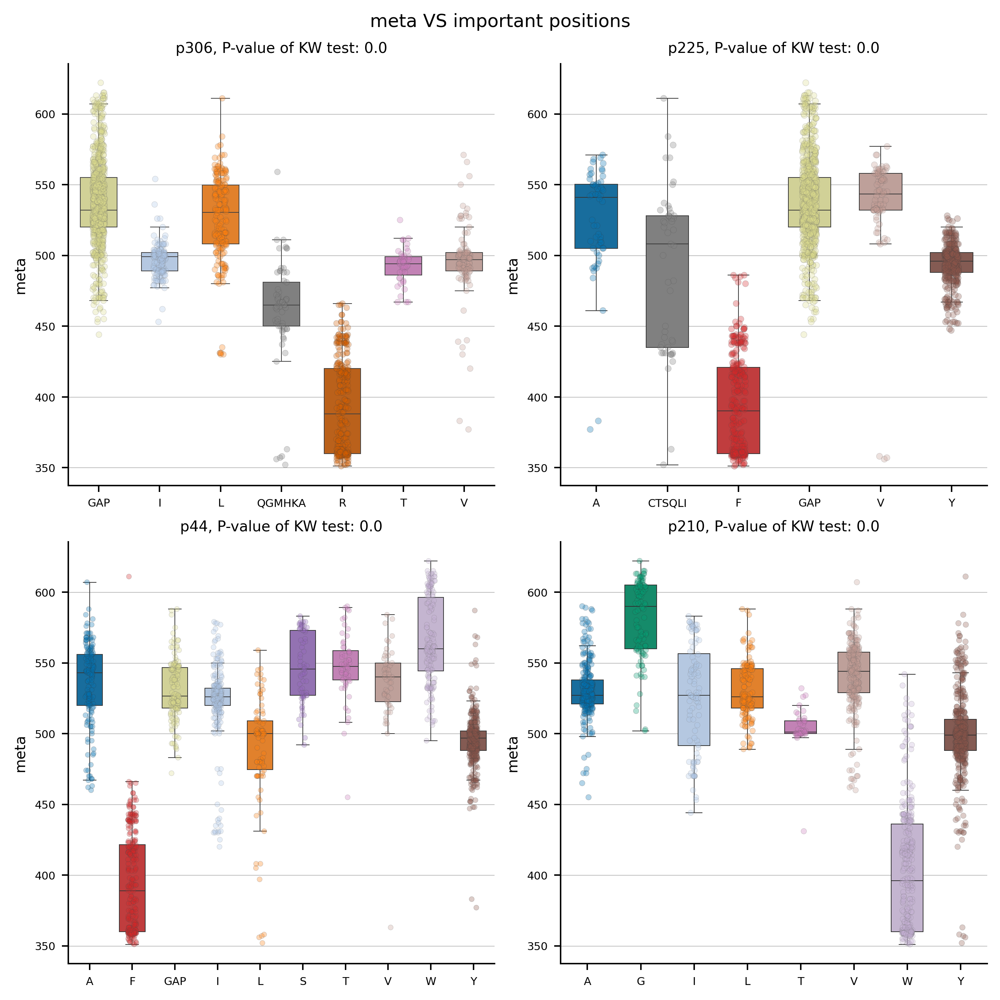

In [32]:
for model in top:
    model_name = model.steps[-1][0]
    dp_plot(importance=importance_from_pipe(model),
            imp_col='standard_value',
            model_name = model_name, report_dir=report_dir)
    
    plot_imp_model(importance=importance_from_pipe(model), 
               X_train=tr, y_train=y, model_name=model_name,
                   meta_var='meta', model_type=ana_type, report_dir=report_dir)

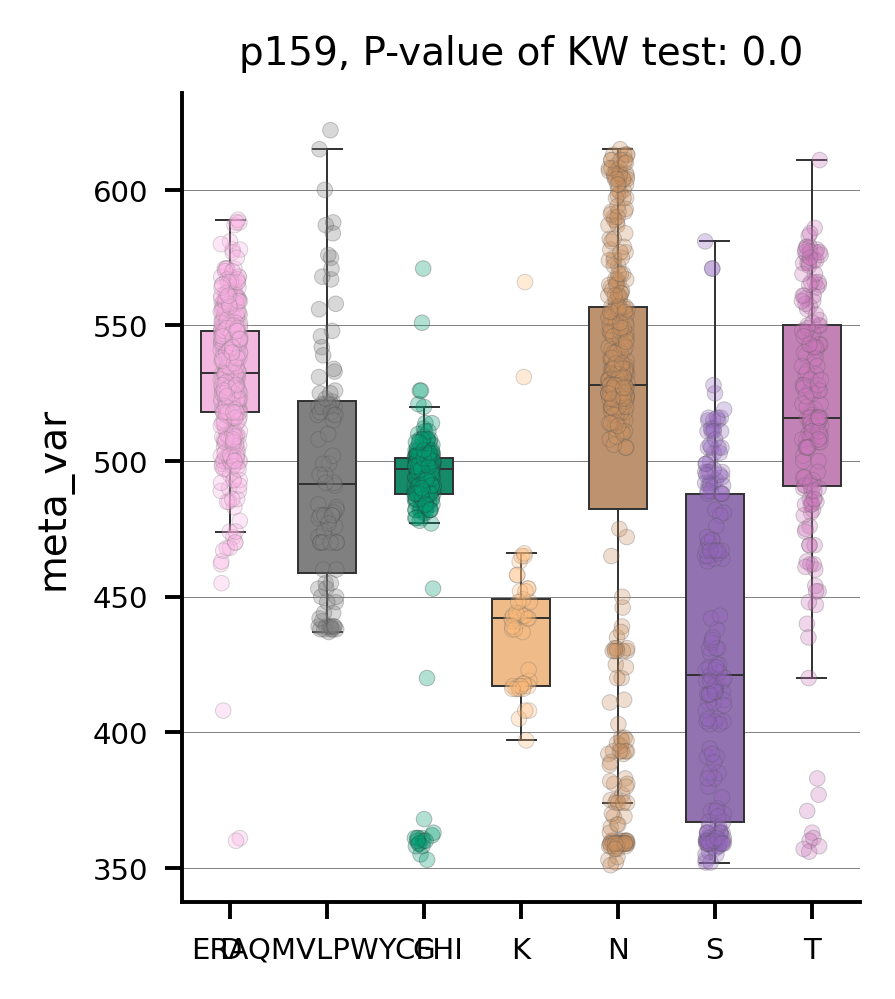

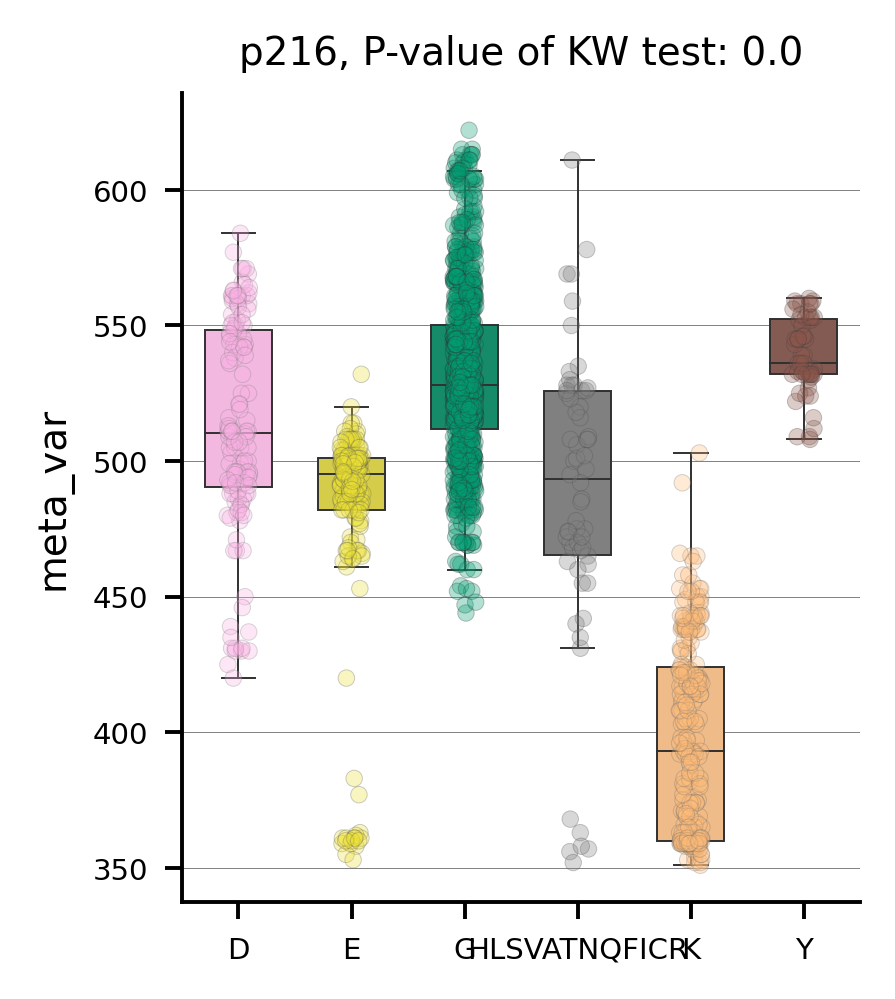

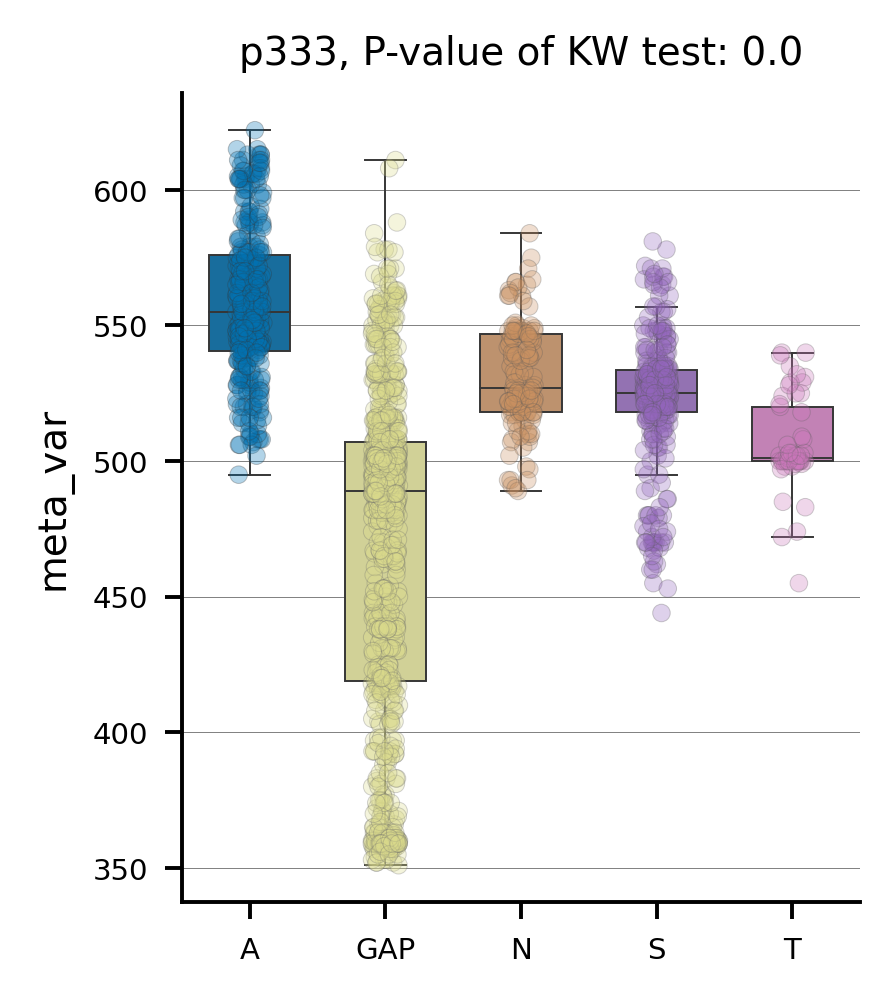

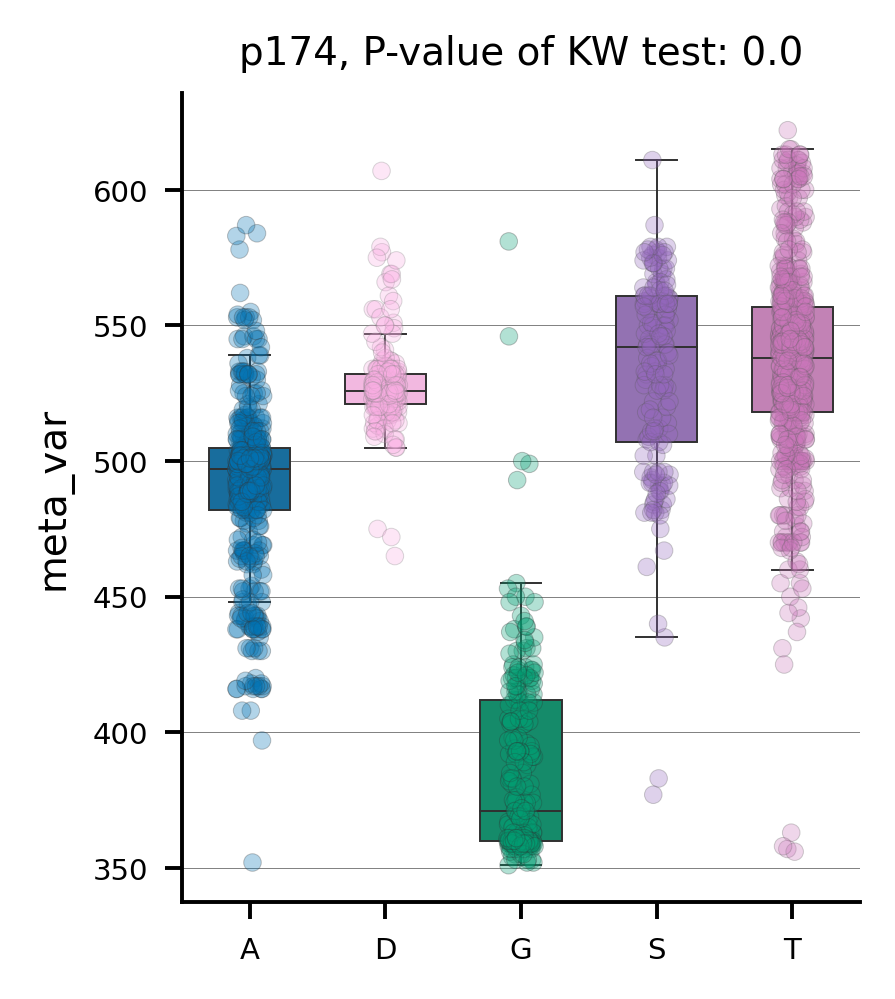

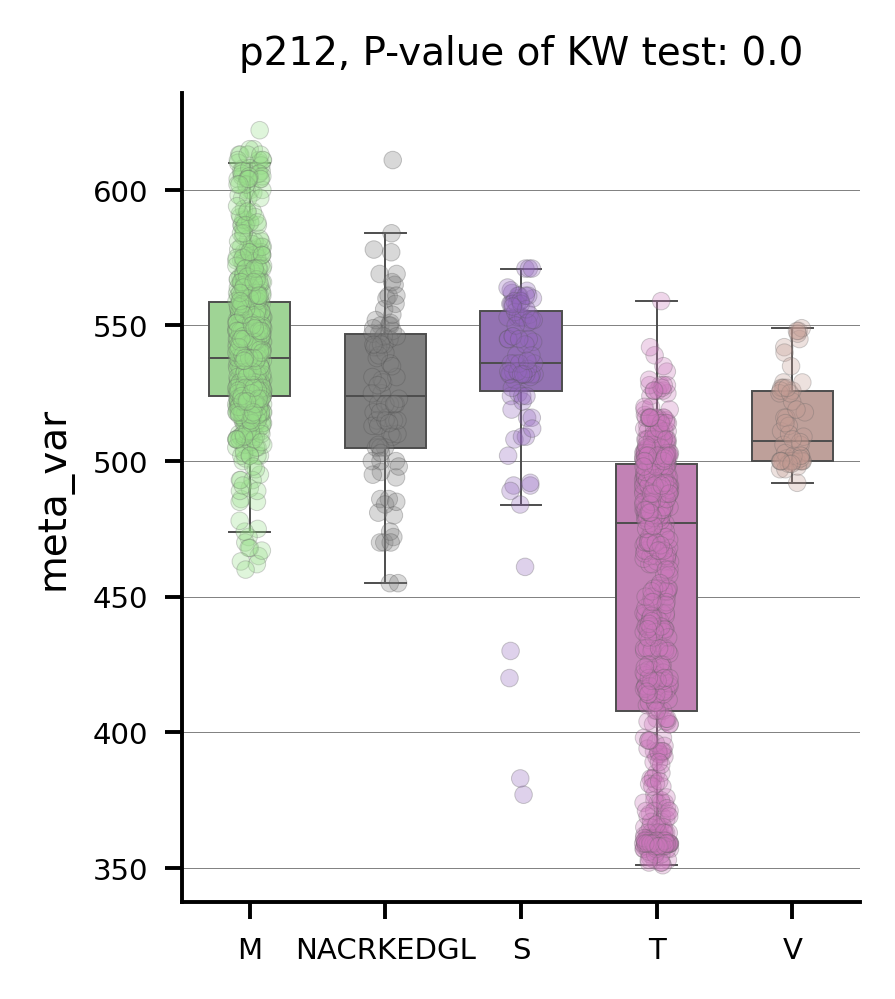

...

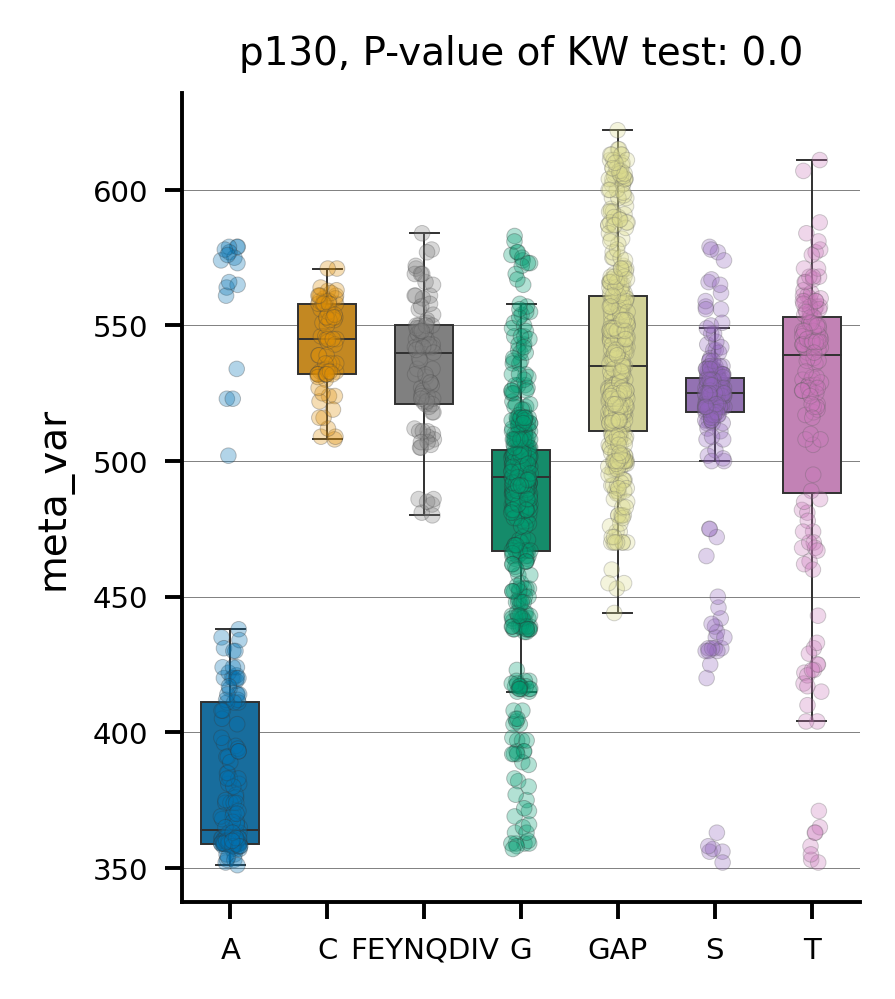

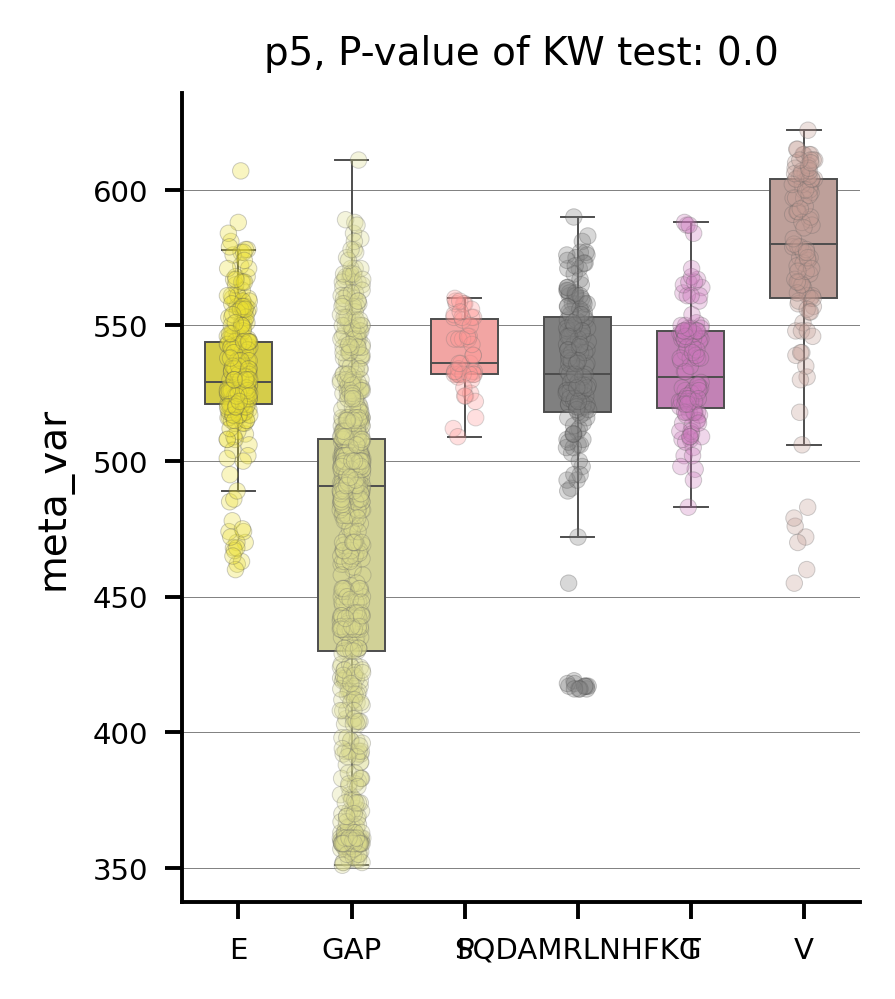

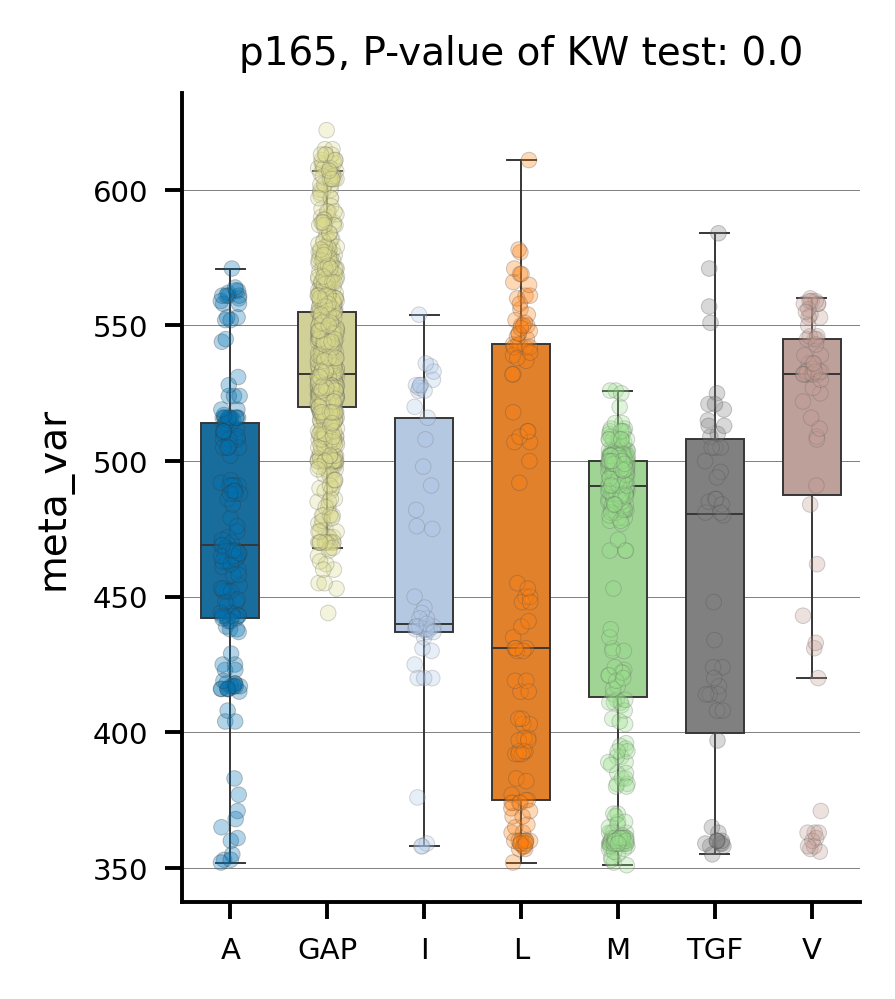

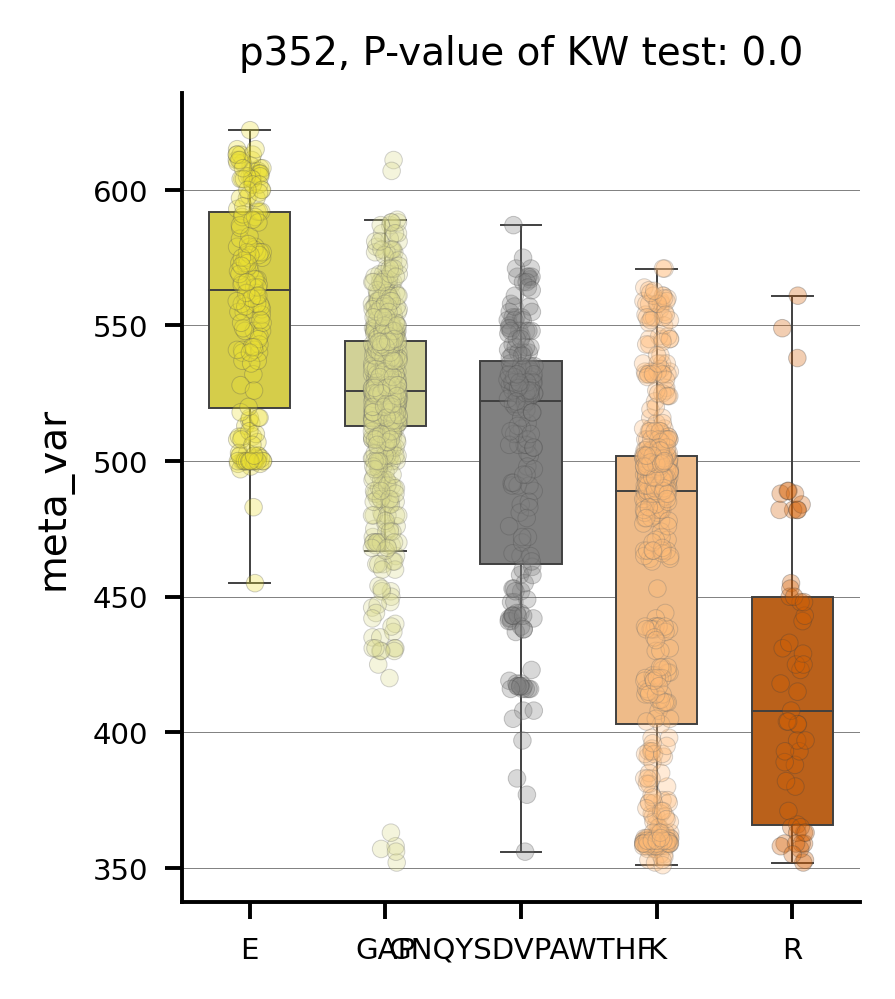

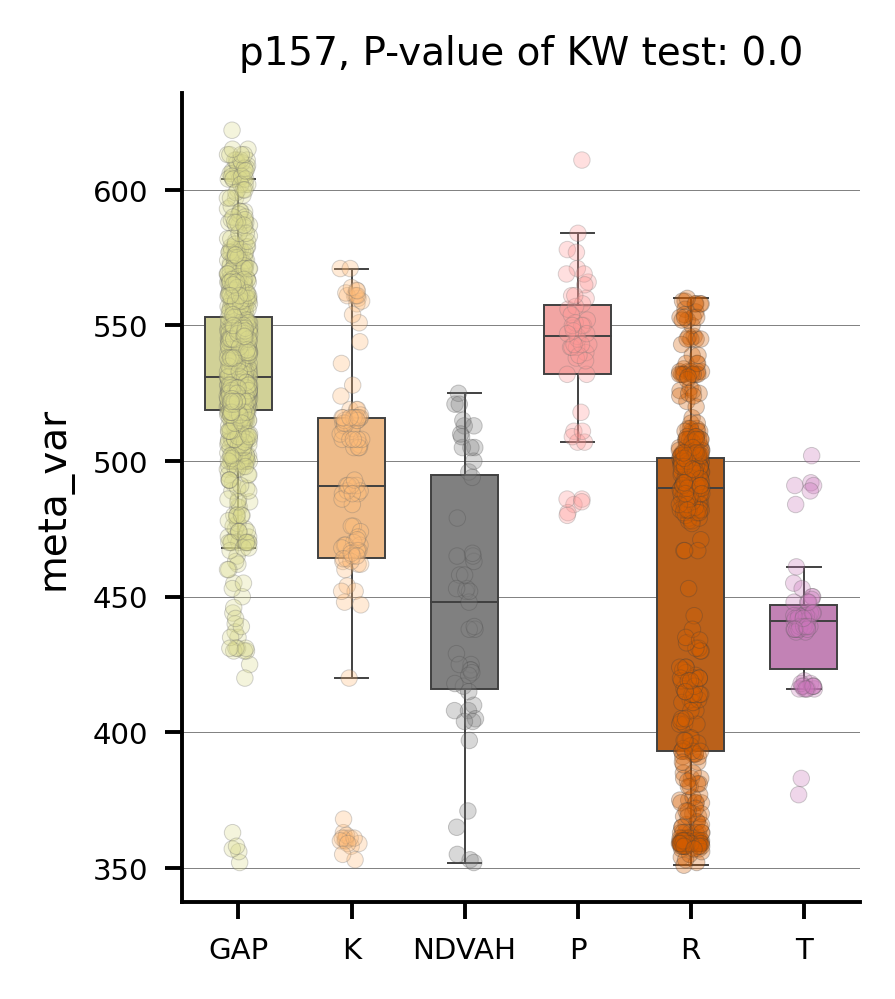

In [33]:
pl = plot_imp_all(final_models=top,
                  X_train=tr, y_train=y,
                  model_type = ana_type,
                  report_dir=report_dir, max_plots=100,
                  figsize=(2.5, 3))

In [34]:
from deepBreaks.utils import load_obj
import joblib
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_squared_error
load_rf = load_obj(report_dir + '/lgbm.pkl')

In [35]:
predictions = load_rf.predict(unseen)
print(predictions)


[374.94929708 498.86357415 519.86149206 568.30323092 568.30323092
 457.58165956 526.60724855 503.38624129 505.36500752 547.45822933
 358.98203984 545.53249731 600.60985912 458.17251728 545.53249731
 520.56445464 554.24985262 517.73616717 372.44540591 507.86336998
 527.09873608 562.21047675 537.97323157 526.81787196 600.60985912
 518.41571011 542.52081438 573.41859737 502.00037917 454.33937531
 488.04071017 498.78556375 524.70484435 494.35422897 527.40253373
 545.18146344 533.58029981 547.55356574 545.18146344 516.28187852
 523.25425716 498.5439766  462.090247   600.60985912 498.82180414
 442.67998456 501.54755626 545.53249731 357.8683909  515.88305659
 498.86357415 357.8683909  569.43300343 526.60724855 503.14371422
 502.47983257 528.75869564 574.29555775 522.97227608 526.60724855
 492.1635851  510.87825084 443.39969978 429.24033298 531.19444323
 554.37182981 357.66919992 595.30739745 600.42551157 600.60985912
 528.68783938 498.86357415 545.53249731 498.5439766  417.40300395
 484.90064

In [36]:
#base_test['Prediction'] = predictions
#base_test['Difference'] = base_test['Prediction'] - base_test['Lambda_Max']
#base_test = base_test[['Species', 'Opsin_Family', 'Accession','Lambda_Max','Prediction','Difference']]

#base_test.to_csv(path_or_buf= f'{report_dir}/basetest_results.csv',index = 'Feature',mode="w")

#base_test.head()

In [37]:
base_test['Prediction'] = predictions
base_test['Difference'] = base_test['Prediction'] - base_test['Lambda_Max']
base_test = base_test[['Lambda_Max','Prediction','Difference']]

base_test.to_csv(path_or_buf= f'{report_dir}/basetest_results.csv',index = 'Feature',mode="w")

base_test.head()

,Lambda_Max,Prediction,Difference
Column1,,,
S673,363.0,374.949297,11.949297
S542,487.0,498.863574,11.863574
S473,517.0,519.861492,2.861492
PoXeR,564.0,568.303231,4.303231
PoXeR,575.0,568.303231,-6.696769


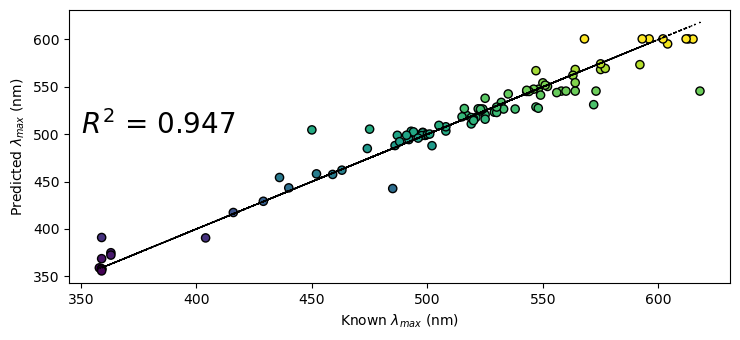

In [38]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(umd, predictions, c=predictions, ec = 'k', edgecolors='k', s = 35)
plt.plot(umd, umd, c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(unseen, umd):.3f}",(350, 500), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/50_hetero_dp.pdf'
plt.savefig(fileout)
plt.show()


In [39]:
model_testing__report = f'{report_dir}/model_testing report.tsv'

base_rsq = load_rf.score(unseen, umd)
print(base_rsq)

base_mae = mean_absolute_error(predictions,umd)
print(base_mae)

base_mape = mean_absolute_percentage_error(predictions,umd)
print(base_mape)

base_sqe = mean_squared_error(predictions,umd)
print(base_sqe)

base_rsqe = mean_squared_error(predictions,umd, squared = False)
print(base_rsqe)

with open(model_testing__report , 'w') as f:
    f.write(f'Base Model R^2\tBase Model MAE\tBase Model MAPE\tBase Model SQE\tBase Model RSQE\n')
    f.write(f'{str(base_rsq)}\t{str(base_mae)}\t{str(base_mape)}\t{str(base_sqe)}\t{str(base_rsqe)}')




0.9473293163035057
8.841541023535276
0.017406095004376197
212.37610681889902
14.573129616485918


In [40]:
msp_predictions = load_rf.predict(msp)
print(msp_predictions)

[512.22777809 433.53414922 546.48718127 446.46178196 425.86217805
 482.96020124 448.00603579 411.04548548 437.50360427 451.95741434
 526.93666757 376.53994892 493.03835536 507.16951683 563.26170282
 508.93646483 462.08838185 525.01050775 387.61328051 510.30133578
 505.74332354 397.69967544 517.11991755 543.05127949 456.85734026
 425.66178722 510.99667037 446.20789481 401.36889175 506.74440553
 455.78229634 458.33998487 458.796046   458.34584916 452.33257863]


In [41]:
meta = "erg_msp_meta.tsv"
msp_meta = pd.read_csv(meta, sep="\t", index_col = False)
msp_meta.head()

,Species,Accession,Lambda_Max
0,Neogonodactylus_oerstedii,KJ127520.1,334
1,Neogonodactylus_oerstedii,KJ127521.1,383
2,Bombus_impatiens,XP_012237087.1,539
3,Bombus_impatiens,XP_003494923.1,424
4,Bombus_impatiens,AAV67326.1,347


In [42]:
lmax_msp = (msp_meta['Lambda_Max'])
lm = []
for i in lmax_msp:
    lm.append(float(i))


In [43]:
columns = ['Species','Accession','Lambda_Max','Predicted','Differnce']
msp_test = pd.DataFrame(index=msp.index, columns = columns)
msp_test['Predicted'] = msp_predictions
msp_test['Species'][0:31] = msp_meta['Species']
msp_test['Accession'][0:31] = msp_meta['Accession']

msp_test.head()

,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,NaN,512.227778,NaN
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,NaN,433.534149,NaN
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,NaN,546.487181,NaN
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,NaN,446.461782,NaN
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,NaN,425.862178,NaN


In [44]:

msp_test['Lambda_Max'][0:31] = lm
msp_test['Differnce'] = msp_test['Predicted'] - msp_test['Lambda_Max']
msp_test.head()


,Species,Accession,Lambda_Max,Predicted,Differnce
Neogonodactylus_oerstedii|334,Neogonodactylus_oerstedii,KJ127520.1,334.0,512.227778,178.227778
Neogonodactylus_oerstedii|383,Neogonodactylus_oerstedii,KJ127521.1,383.0,433.534149,50.534149
Bombus_impatiens|539,Bombus_impatiens,XP_012237087.1,539.0,546.487181,7.487181
Bombus_impatiens|424,Bombus_impatiens,XP_003494923.1,424.0,446.461782,22.461782
Bombus_impatiens|347,Bombus_impatiens,AAV67326.1,347.0,425.862178,78.862178


In [45]:
msp_test.to_csv(path_or_buf= f'{report_dir}/msp_test_results.csv',index = 'Feature',mode="w")

In [46]:
mae = mean_absolute_error(msp_test['Predicted'][0:31], msp_test['Lambda_Max'][0:31])
print(mae)
msp_rsq = load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31])
print(msp_rsq)


34.27625424127668
0.518855991787144


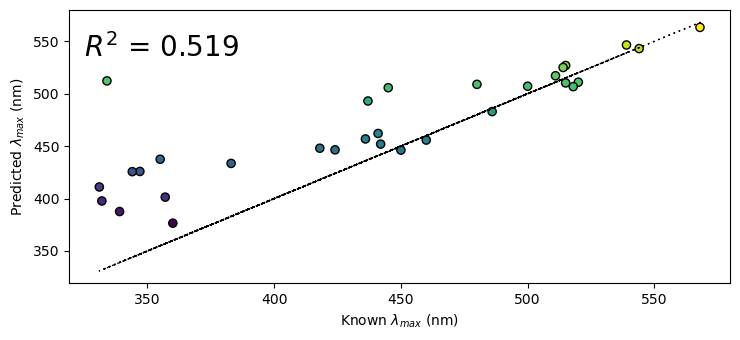

In [47]:
plt.rcParams["figure.autolayout"] = True
plt.rcParams["figure.figsize"] = [7.50, 3.50]

plt.scatter(msp_test['Lambda_Max'][0:31], msp_predictions[0:31], c=msp_predictions[0:31], ec = 'k', edgecolors='k', s = 35)
plt.plot(msp_test['Lambda_Max'][0:31], msp_test['Lambda_Max'][0:31], c = 'k', linewidth = '1.0', ls = '--', dashes = (1,3))
plt.xlabel('Known $λ_{max}$ (nm)')
plt.ylabel('Predicted $λ_{max}$ (nm)')
plt.annotate(f"$R^2$ = {load_rf.score(msp[0:31], msp_test['Lambda_Max'][0:31]):.3f}",(325, 535), fontsize = 20, c = 'k')
plt.rcParams["figure.figsize"] = [7.50, 3.50]


#start, end = plt.get_xlim()
#plt.xaxis.set_ticks(np.arange(start, end, 25))
fileout = f'{report_dir}/31_msp_dp.pdf'
plt.savefig(fileout)
plt.show()

Below is just a way for me to properly format test data for previously trained models using the base training data... 

# importing deepBreaks libraries 
from deepBreaks.utils import get_models, get_scores, get_params, make_pipeline
from deepBreaks.preprocessing import MisCare, ConstantCare, URareCare, CustomOneHotEncoder
from deepBreaks.preprocessing import FeatureSelection, CollinearCare
from deepBreaks.preprocessing import read_data
from deepBreaks.models import model_compare_cv, finalize_top, importance_from_pipe, mean_importance, summarize_results
from deepBreaks.visualization import plot_scatter, dp_plot, plot_imp_model, plot_imp_all
import warnings
import datetime
import os
import numpy as np
import csv
import pandas as pd

# defining user params, file pathes, analysis type

# path to sequences
seqFileName = 'wds_fmt_msp.fasta' 

# path to metadata
metaDataFileName = 'wds_meta.tsv' 

# name of the phenotype
mt = 'Lambda_Max'

# type of the sequences
seq_type = 'aa'

# type of the analysis if it is a classification model, then we put cl instead of reg
ana_type = 'reg' 

# making a unique directory for saving the reports of the analysis
print('direcory preparation')
dt_label = datetime.datetime.now().strftime('%Y-%m-%d_%H-%M-%S')
seqFile = seqFileName.split('.')[0]
report_dir = str(seqFile +'_' + mt + '_' + dt_label)
os.makedirs(report_dir)

print('reading meta-data')
# importing metadata
meta_data = read_data(metaDataFileName, seq_type = None, is_main=False)

# importing sequences data
print('reading fasta file')
tr = read_data(seqFileName, seq_type = seq_type, is_main=True, gap_threshold=0.6)

#start here with removing the bottom ~25 sequences 
msp = tr.iloc[856:].copy()
msp.head()

tr = tr.merge(meta_data.loc[:, mt],  left_index=True, right_index=True)
tr.shape

sample_n = 50
n = 0
while n < 1:
    drop_indices = np.random.choice(tr.index, sample_n, replace=False)
    #print(drop_indices)
    #drop_indices = np.append(drop_indices,['Bovine'])
    #print(drop_indices)
    if 'Bovine' in drop_indices:
        pass
    else:
        n+=1

unseen = tr.loc[drop_indices].copy()
umd = unseen.loc[:, mt].values

unseen.drop(mt, axis=1, inplace=True)
tr = tr.drop(drop_indices)

y = tr.loc[:, mt].values
tr.drop(mt, axis=1, inplace=True)
print('Shape of data is: ', tr.shape)


# <font color=red>STEP 4: Translate Candidate STSs</font> 
## Optional step IF running the classifier model, but could still be useful.
### To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
### Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.

In [48]:
import pandas as pd
import os

In [49]:
#STEP 4: Translate Candidate STSs 
#Optional step IF running the classifier model, but could still be useful.
#To find CSTSs, got to the deepBreaks output folder and find the excel sheet 'avg_top_models_feature_importance'
#Sort the top model's feature importance column by 'largest-to-smallest' and take x# of those positions.
m = 0
tm = ''
k=0
gaps=0
#import importance_report.csv from report_dir
true_pos = []
aa = []
tmd = []

df = pd.read_csv(f'{report_dir}\importance_report.csv')

#take the list of important sites and translate them to the bovine standard equivalent, we do this by taking the site number and subtracting the number of '-' between the start of the sequence and the desired site. 
for rows in bovine.values:  
    rows = str(rows)
    print(rows)
    if rows == 'nan':
    #We want to write the 'true_pos', 'aa', and 'TMD' to the 'importance_report' csv file
        gaps += 1
        k += 1
        true_pos.append('NA')
        aa.append('-')
        tmd.append('NA')
    else:
        #print("The number of gaps is " + str(gaps))
        k+=1
        trans_site = k - gaps

        if trans_site in range(39,66):
            tm = '1'
        elif trans_site in range(3,38):
            tm = 'N-Termina'
        elif trans_site in range(72,100):
            tm = '2'
        elif trans_site in range(110,141):
            tm = '3'
        elif trans_site in range(151,174):
            tm = '4'
        elif trans_site in range(200,231):
            tm = '5'
        elif trans_site in range(245,276):
            tm = '6'
        elif trans_site in range(285,311):
            tm = '7'
        else:
            tm = 'NA'
        
        true_pos.append(str(trans_site))
        aa.append(rows)
        tmd.append(tm)
true_pos.pop()
aa.pop()
tmd.pop()

df['true_position'] = true_pos
df['TMD'] = tmd
df['amino_acid'] = aa

df.to_csv(path_or_buf= os.path.join(report_dir,r'importance_report.csv'),index = 'Feature',mode="w")
df.head()


M
G
T
E
nan
G
P
N
F
Y
V
F
nan
nan
S
N
K
T
G
V
V
R
S
P
F
E
A
P
Q
Y
Y
L
A
E
P
W
Q
F
S
M
L
A
A
Y
M
F
L
L
I
M
L
G
F
P
I
N
F
L
nan
T
L
Y
V
T
V
Q
H
K
K
L
R
T
P
nan
nan
nan
nan
nan
nan
nan
L
N
Y
I
L
L
N
L
A
V
A
D
L
F
M
V
F
G
G
F
T
T
T
L
nan
Y
T
S
L
H
G
Y
F
V
F
G
P
T
G
C
N
L
E
G
F
F
A
T
L
G
G
E
I
A
L
W
S
L
V
V
L
A
I
E
R
Y
V
V
V
C
K
P
M
S
N
F
R
F
G
E
N
H
A
I
M
G
V
A
F
T
W
V
M
A
L
A
C
A
A
P
P
L
V
G
nan
W
S
R
Y
I
P
E
G
M
Q
C
nan
nan
nan
nan
nan
nan
nan
nan
S
C
G
I
D
Y
Y
T
P
H
E
E
T
N
N
E
S
F
V
I
Y
M
F
V
V
H
F
I
I
P
L
I
V
I
F
F
C
Y
G
Q
L
V
F
T
V
K
E
A
A
A
Q
Q
Q
E
S
A
T
T
Q
K
A
E
K
E
V
T
R
M
V
I
nan
I
M
V
I
A
F
L
I
C
W
L
P
Y
A
G
V
A
F
Y
I
F
T
H
Q
G
S
D
F
G
P
I
F
M
T
I
P
A
F
F
A
K
T
S
A
V
Y
N
P
V
I
Y
I
M
M
nan
nan
nan
nan
N
K
Q
F
R
N
C
M
V
T
T
L
C
nan
nan
nan
C
G
K
P
L
G
nan
D
D
E
nan
A
S
T
T
V
S
K
T
E
nan
nan
nan
nan
nan
T
S
Q
V
A
P
A


,feature,BayesianRidge,lgbm,xgb,mean,true_position,TMD,amino_acid
0,1,0.103628,0.308123,0.000048,0.137267,1,NA,M
1,2,0.066277,0.016807,0.000051,0.027712,2,NA,G
2,3,0.161510,0.159664,0.000075,0.107083,3,N-Termina,T
3,4,0.106606,0.084034,0.000446,0.063695,4,N-Termina,E
4,5,0.155699,0.117647,0.000325,0.091224,NA,NA,-
